# Covid19 Worldnews 

#### Import libraries

In [1]:
# datascience
import numpy as np 
import pandas as pd 

# plot
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib.image as image
from matplotlib.offsetbox import TextArea, DrawingArea, OffsetImage, AnnotationBbox
import matplotlib.image as mpimg
import flag

# files
import urllib.request
import cairosvg

from IPython.core.display import HTML

pd.set_option('display.max_colwidth', -1)

<ipython-input-1-6c82811a6d51>:21: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


## Exploration

#### General information

In [2]:
data = pd.read_csv("../data/covid19.csv")
data.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy
0,AFG,Asia,Afghanistan,2019-12-31,0.0,0.0,NaN,0.0,0.0,NaN,...,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83
1,AFG,Asia,Afghanistan,2020-01-01,0.0,0.0,NaN,0.0,0.0,NaN,...,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83
2,AFG,Asia,Afghanistan,2020-01-02,0.0,0.0,NaN,0.0,0.0,NaN,...,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83
3,AFG,Asia,Afghanistan,2020-01-03,0.0,0.0,NaN,0.0,0.0,NaN,...,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83
4,AFG,Asia,Afghanistan,2020-01-04,0.0,0.0,NaN,0.0,0.0,NaN,...,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37839 entries, 0 to 37838
Data columns (total 40 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   iso_code                         37768 non-null  object 
 1   continent                        37536 non-null  object 
 2   location                         37839 non-null  object 
 3   date                             37839 non-null  object 
 4   total_cases                      37261 non-null  float64
 5   new_cases                        37261 non-null  float64
 6   new_cases_smoothed               36480 non-null  float64
 7   total_deaths                     37261 non-null  float64
 8   new_deaths                       37261 non-null  float64
 9   new_deaths_smoothed              36480 non-null  float64
 10  total_cases_per_million          37197 non-null  float64
 11  new_cases_per_million            37197 non-null  float64
 12  new_cases_smoothed

In [4]:
df = data[['iso_code','date', 'location', 'continent', 'total_deaths', 'total_cases', 'population']]

#### Continents

In [5]:
continents = df.continent.unique()
continents

array(['Asia', 'Europe', 'Africa', 'North America', 'South America',
       'Oceania', nan], dtype=object)

#### Country

In [6]:
countries = df.location.unique()
print(countries)

['Afghanistan' 'Albania' 'Algeria' 'Andorra' 'Angola' 'Anguilla'
 'Antigua and Barbuda' 'Argentina' 'Armenia' 'Aruba' 'Australia' 'Austria'
 'Azerbaijan' 'Bahamas' 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus'
 'Belgium' 'Belize' 'Benin' 'Bermuda' 'Bhutan' 'Bolivia'
 'Bonaire Sint Eustatius and Saba' 'Bosnia and Herzegovina' 'Botswana'
 'Brazil' 'British Virgin Islands' 'Brunei' 'Bulgaria' 'Burkina Faso'
 'Burundi' 'Cambodia' 'Cameroon' 'Canada' 'Cape Verde' 'Cayman Islands'
 'Central African Republic' 'Chad' 'Chile' 'China' 'Colombia' 'Comoros'
 'Congo' 'Costa Rica' "Cote d'Ivoire" 'Croatia' 'Cuba' 'Curacao' 'Cyprus'
 'Czech Republic' 'Democratic Republic of Congo' 'Denmark' 'Djibouti'
 'Dominica' 'Dominican Republic' 'Ecuador' 'Egypt' 'El Salvador'
 'Equatorial Guinea' 'Eritrea' 'Estonia' 'Ethiopia' 'Faeroe Islands'
 'Falkland Islands' 'Fiji' 'Finland' 'France' 'French Polynesia' 'Gabon'
 'Gambia' 'Georgia' 'Germany' 'Ghana' 'Gibraltar' 'Greece' 'Greenland'
 'Grenada' 'Guam' 'Guatemala

In [7]:
# Drop World and International

df = df[df.location != 'World']
df = df[df.location != 'International']
df.head()

,iso_code,date,location,continent,total_deaths,total_cases,population
0,AFG,2019-12-31,Afghanistan,Asia,0.0,0.0,38928341.0
1,AFG,2020-01-01,Afghanistan,Asia,0.0,0.0,38928341.0
2,AFG,2020-01-02,Afghanistan,Asia,0.0,0.0,38928341.0
3,AFG,2020-01-03,Afghanistan,Asia,0.0,0.0,38928341.0
4,AFG,2020-01-04,Afghanistan,Asia,0.0,0.0,38928341.0


In [8]:
df

,iso_code,date,location,continent,total_deaths,total_cases,population
0,AFG,2019-12-31,Afghanistan,Asia,0.0,0.0,38928341.0
1,AFG,2020-01-01,Afghanistan,Asia,0.0,0.0,38928341.0
2,AFG,2020-01-02,Afghanistan,Asia,0.0,0.0,38928341.0
3,AFG,2020-01-03,Afghanistan,Asia,0.0,0.0,38928341.0
4,AFG,2020-01-04,Afghanistan,Asia,0.0,0.0,38928341.0
...,...,...,...,...,...,...,...
37531,ZWE,2020-08-14,Zimbabwe,Africa,128.0,4990.0,14862927.0
37532,ZWE,2020-08-15,Zimbabwe,Africa,128.0,5072.0,14862927.0
37533,ZWE,2020-08-16,Zimbabwe,Africa,130.0,5176.0,14862927.0
37534,ZWE,2020-08-17,Zimbabwe,Africa,132.0,5261.0,14862927.0


#### Flags

In [9]:
flags = pd.read_csv("../data/Country_Flags.csv")

In [10]:
flags.head()

,Country,Images File Name,ImageURL
0,Afghanistan,Flag_of_Afghanistan.svg,https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg
1,Albania,Flag_of_Albania.svg,https://upload.wikimedia.org/wikipedia/commons/3/36/Flag_of_Albania.svg
2,Algeria,Flag_of_Algeria.svg,https://upload.wikimedia.org/wikipedia/commons/7/77/Flag_of_Algeria.svg
3,Andorra,Flag_of_Andorra.svg,https://upload.wikimedia.org/wikipedia/commons/1/19/Flag_of_Andorra.svg
4,Angola,Flag_of_Angola.svg,https://upload.wikimedia.org/wikipedia/commons/9/9d/Flag_of_Angola.svg


In [11]:
# Rename Country to location to match the first dataframe
flags = flags.rename(columns ={'Country':'location'})
# Drop files name
flags = flags[['location', 'ImageURL']]

In [12]:
# Merge the two dataframe
df_flags = pd.merge(df, flags, on='location')

In [13]:
df_flags.head()

,iso_code,date,location,continent,total_deaths,total_cases,population,ImageURL
0,AFG,2019-12-31,Afghanistan,Asia,0.0,0.0,38928341.0,https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg
1,AFG,2020-01-01,Afghanistan,Asia,0.0,0.0,38928341.0,https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg
2,AFG,2020-01-02,Afghanistan,Asia,0.0,0.0,38928341.0,https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg
3,AFG,2020-01-03,Afghanistan,Asia,0.0,0.0,38928341.0,https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg
4,AFG,2020-01-04,Afghanistan,Asia,0.0,0.0,38928341.0,https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg


In [14]:
df_flags = df_flags.rename(columns ={'total_deaths':'Deaths', 'total_cases':'Cases'})
df_flags.sample(5)

,iso_code,date,location,continent,Deaths,Cases,population,ImageURL
29825,THA,2020-03-08,Thailand,Asia,NaN,NaN,69799978.0,https://upload.wikimedia.org/wikipedia/commons/a/a9/Flag_of_Thailand.svg
23562,PRY,2020-07-06,Paraguay,South America,20.0,2427.0,7132530.0,https://upload.wikimedia.org/wikipedia/commons/2/27/Flag_of_Paraguay.svg
31735,URY,2020-06-11,Uruguay,South America,23.0,847.0,3473727.0,https://upload.wikimedia.org/wikipedia/commons/f/fe/Flag_of_Uruguay.svg
10549,FRA,2020-01-10,France,Europe,0.0,0.0,65273512.0,https://upload.wikimedia.org/wikipedia/en/c/c3/Flag_of_France.svg
4165,BIH,2020-08-16,Bosnia and Herzegovina,Europe,469.0,15535.0,3280815.0,https://upload.wikimedia.org/wikipedia/commons/b/bf/Flag_of_Bosnia_and_Herzegovina.svg


#### Flags pictures

In [15]:
def path_to_image_html(path):
    return '<img src="'+ path + '" width="60" >'

In [89]:
df_flags.to_html(escape=False, formatters=dict(ImageURL=path_to_image_html))

'<table border="1" class="dataframe">\n  <thead>\n    <tr style="text-align: right;">\n      <th></th>\n      <th>iso_code</th>\n      <th>date</th>\n      <th>location</th>\n      <th>continent</th>\n      <th>deaths</th>\n      <th>cases</th>\n      <th>population</th>\n      <th>ImageURL</th>\n    </tr>\n  </thead>\n  <tbody>\n    <tr>\n      <th>0</th>\n      <td>AFG</td>\n      <td>2019-12-31</td>\n      <td>Afghanistan</td>\n      <td>Asia</td>\n      <td>0.0</td>\n      <td>0.0</td>\n      <td>3.892834e+07</td>\n      <td><img src="https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg" width="60" ></td>\n    </tr>\n    <tr>\n      <th>1</th>\n      <td>AFG</td>\n      <td>2020-01-01</td>\n      <td>Afghanistan</td>\n      <td>Asia</td>\n      <td>0.0</td>\n      <td>0.0</td>\n      <td>3.892834e+07</td>\n      <td><img src="https://upload.wikimedia.org/wikipedia/commons/9/9a/Flag_of_Afghanistan.svg" width="60" ></td>\n    </tr>\n    <tr>\n      <th>2</th>\n

In [62]:
covid = HTML(df_flags.to_html(escape=False,formatters=dict(ImageURL=path_to_image_html)))
covid

,iso_code,date,location,continent,total_deaths,total_cases,population,ImageURL
0,AFG,2019-12-31,Afghanistan,Asia,0.0,0.0,3.892834e+07,
1,AFG,2020-01-01,Afghanistan,Asia,0.0,0.0,3.892834e+07,
2,AFG,2020-01-02,Afghanistan,Asia,0.0,0.0,3.892834e+07,
3,AFG,2020-01-03,Afghanistan,Asia,0.0,0.0,3.892834e+07,
4,AFG,2020-01-04,Afghanistan,Asia,0.0,0.0,3.892834e+07,
5,AFG,2020-01-05,Afghanistan,Asia,0.0,0.0,3.892834e+07,
6,AFG,2020-01-06,Afghanistan,Asia,0.0,0.0,3.892834e+07,
7,AFG,2020-01-07,Afghanistan,Asia,0.0,0.0,3.892834e+07,
8,AFG,2020-01-08,Afghanistan,Asia,0.0,0.0,3.892834e+07,
9,AFG,2020-01-09,Afghanistan,Asia,0.0,0.0,3.892834e+07,


In [16]:
#Numbers of missing values
missing_data = df_flags.isnull().sum(axis=0).reset_index()
missing_data.columns = ['feature', 'missing values']
missing_data['filling factor (%)']=(df_flags.shape[0]-missing_data['missing values'])/df.shape[0]*100
missing_data.sort_values('filling factor (%)').reset_index(drop = True)

,feature,missing values,filling factor (%)
0,Deaths,513,85.973465
1,Cases,513,85.973465
2,iso_code,0,87.340153
3,date,0,87.340153
4,location,0,87.340153
5,continent,0,87.340153
6,population,0,87.340153
7,ImageURL,0,87.340153


In [20]:
df_flags = df_flags.fillna(0)

#### Save flags as png

In [72]:
df_url = df_flags[df_flags.date=='2020-07-31']

for url in df_url.ImageURL:
    country = df_url[df_url.ImageURL ==url].location.values
    country = str(country)
    country = country[2:-2]
    
    try:
        img = urllib.request.urlretrieve(url, '../data/country_flags/' + country + '.svg')
        cairosvg.svg2png(url='../data/country_flags/' + country + '.svg', 
                        write_to='../data/country_flags/' + country + '.png')
    except:
        df_flags = df_flags[df_flags.location != 'country']

## Race bar chart

#### Settings

In [75]:
colors = dict(zip
    (["Europe", "Asia", "South America", "Oceania", "North America", "Africa"],
    ["#1D294C", "#d96c73" , "#bdc4db", "#d9abae","#E30613" , "#E30613"]))

group_lk = df_flags.set_index('location')['continent'].to_dict()

TypeError: add_artist() got an unexpected keyword argument 'xy'

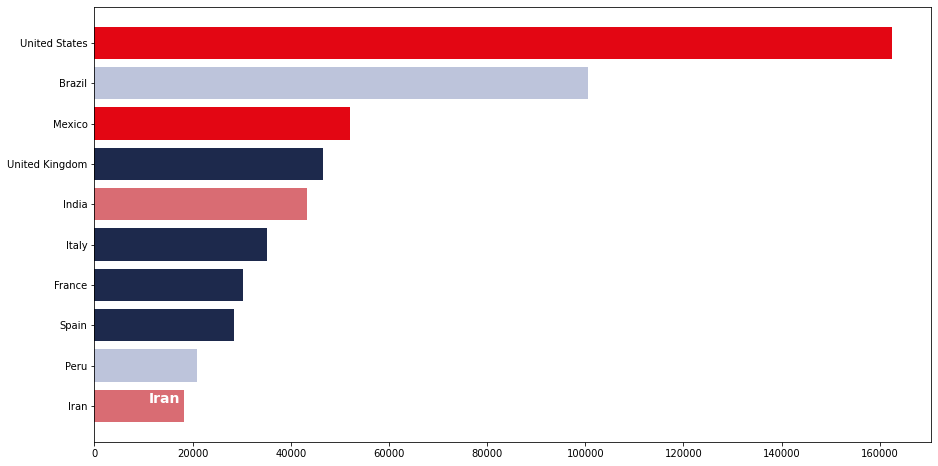

In [79]:
fig, ax = plt.subplots(figsize=(15, 8))
def draw_barchart(date, value):
    #get the 10first values for deaths or cases
    dff = df_flags[df_flags['date'].eq(date)].sort_values(by=value, ascending=True).tail(10)
    
    #clean axes
    ax.clear()
    
    #barchart
    ax.barh(dff['location'], dff[value], color=[colors[group_lk[x]] for x in dff['location']])
    
    #location of information
    dx = dff[value].max() / 200
    for i, (values, name) in enumerate(zip(dff[value], dff['location'])):
        #country name
        ax.text(values-dx, i,     name, color='#ffffff',          size=14, weight=600, ha='right', va='bottom')
        #flags
        flag = mpimg.imread('../data/country_flags/'+ name + '.png')
        imagebox = OffsetImage(flag, zoom=0.2)
        ab = AnnotationBbox(imagebox, (0.4, 0.6))
        ax.add_artist(ab, xy = values-dx)
        #continent
        ax.text(values-dx, i-.25, group_lk[name], size=10, color='#e3e3e3', ha='right', va='baseline')
        #number of cases or deaths
        ax.text(values+dx, i, "{:.0f}".format(values),  size=14, ha='left',  va='center')
        
    #date
    ax.text(1, 0.4, date, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    #x axis setting
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    #y axis settings
    ax.set_yticks([])
    #margins
    ax.margins(0, 0.01)
    #grid
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    #title
    ax.text(0, 1.12, 'Number of deaths by countries',
            transform=ax.transAxes, size=24, weight=600, ha='left')
    #subtitle
    ax.text(0, 1.06, value, transform=ax.transAxes, size=12, color='#777777')
    #author
    ax.text(1, 0, 'by Célia Bayet', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
    
    plt.box(False)
    
draw_barchart('2020-08-09', 'deaths')

In [12]:
dates = df.date.unique()

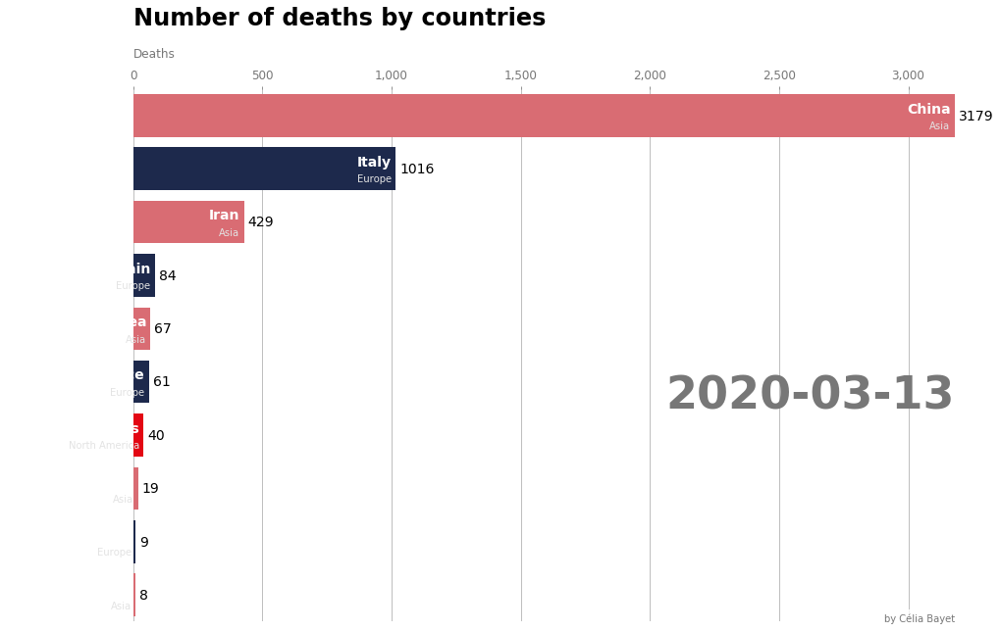

In [19]:
import matplotlib.animation as animation
from IPython.display import HTML

dates = df.date.unique()
fig, ax = plt.subplots(figsize=(15, 10))
animator = animation.FuncAnimation(fig, draw_barchart, frames=dates, fargs=('total_deaths',),save_count=400)
HTML(animator.to_jshtml()) 
# or use animator.to_html5_video() or animator.save()

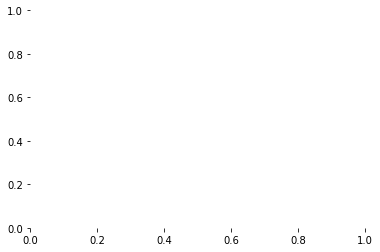

In [22]:
animator.save('covid_deaths.gif', writer='imagemagick', fps=3)

In [13]:
democracy = pd.read_csv("../data/political_regime.csv")
democracy.head()

,Entity,Code,Year,Political Regime (OurWorldInData based on Polity IV and Wimmer & Min) (Score)
0,Afghanistan,AFG,1816,-6
1,Afghanistan,AFG,1817,-6
2,Afghanistan,AFG,1818,-6
3,Afghanistan,AFG,1819,-6
4,Afghanistan,AFG,1820,-6


In [14]:
democracy_today = democracy[democracy.Year==2015]
democracy_today = democracy_today.rename(
    columns =
    {
    'Entity':'location',
    'Political Regime (OurWorldInData based on Polity IV and Wimmer & Min) (Score)': 'democracy_score'})

democracy_today.head()

,location,Code,Year,democracy_score
176,Afghanistan,AFG,2015,-1
375,Albania,ALB,2015,9
575,Algeria,DZA,2015,2
775,Angola,AGO,2015,-2
966,Argentina,ARG,2015,9


In [15]:
democracy_today = democracy_today[['location', 'democracy_score']]
democracy_today.head()

,location,democracy_score
176,Afghanistan,-1
375,Albania,9
575,Algeria,2
775,Angola,-2
966,Argentina,9


In [16]:
cases = df[df.date == '2020-07-31']

In [17]:
cases.head()

,date,location,continent,total_deaths,total_cases,population
130,2020-07-31,Aruba,North America,3.0,120.0,106766.0
344,2020-07-31,Afghanistan,Asia,1271.0,36542.0,38928341.0
486,2020-07-31,Angola,Africa,48.0,1078.0,32866268.0
623,2020-07-31,Anguilla,North America,0.0,3.0,15002.0
778,2020-07-31,Albania,Europe,154.0,5197.0,2877800.0


In [18]:
df_merge = pd.merge(cases, democracy_today, on='location')

In [19]:
df_merge.head()

,date,location,continent,total_deaths,total_cases,population,democracy_score
0,2020-07-31,Afghanistan,Asia,1271.0,36542.0,38928341.0,-1
1,2020-07-31,Angola,Africa,48.0,1078.0,32866268.0,-2
2,2020-07-31,Albania,Europe,154.0,5197.0,2877800.0,9
3,2020-07-31,United Arab Emirates,Asia,351.0,60506.0,9890400.0,-8
4,2020-07-31,Argentina,South America,3311.0,178983.0,45195777.0,9


In [20]:
df_merge['percentage_deaths'] = (df_merge['total_deaths']/df_merge['population'])*100
df_merge['percentage_cases'] = (df_merge['total_cases']/df_merge['population'])*100

In [21]:
df_merge.head()

,date,location,continent,total_deaths,total_cases,population,democracy_score,percentage_deaths,percentage_cases
0,2020-07-31,Afghanistan,Asia,1271.0,36542.0,38928341.0,-1,0.003265,0.093870
1,2020-07-31,Angola,Africa,48.0,1078.0,32866268.0,-2,0.000146,0.003280
2,2020-07-31,Albania,Europe,154.0,5197.0,2877800.0,9,0.005351,0.180589
3,2020-07-31,United Arab Emirates,Asia,351.0,60506.0,9890400.0,-8,0.003549,0.611765
4,2020-07-31,Argentina,South America,3311.0,178983.0,45195777.0,9,0.007326,0.396017


In [22]:
comparative_cases_democracy = df_merge

In [97]:
comparative_cases_democracy.to_csv('comparative_cases_democracy.csv', sep='\t', encoding='utf-8',index=False)

In [23]:
deaths.head()

NameError: name 'deaths' is not defined

In [24]:
comparative_cases_democracy = comparative_cases_democracy[comparative_cases_democracy.population > 30000000]

In [97]:
comparative_cases_democracy

,date,location,continent,total_deaths,total_cases,population,democracy_score,percentage_deaths,percentage_cases,score
0,2020-07-31,Afghanistan,Asia,1271.0,36542.0,3.892834e+07,-1,0.003265,0.093870,2
1,2020-07-31,Angola,Africa,48.0,1078.0,3.286627e+07,-2,0.000146,0.003280,2
4,2020-07-31,Argentina,South America,3311.0,178983.0,4.519578e+07,9,0.007326,0.396017,4
13,2020-07-31,Bangladesh,Asia,3083.0,234889.0,1.646894e+08,1,0.001872,0.142625,2
18,2020-07-31,Brazil,South America,91263.0,2610102.0,2.125594e+08,8,0.042935,1.227940,4
22,2020-07-31,Canada,North America,8929.0,115785.0,3.774216e+07,10,0.023658,0.306779,4
25,2020-07-31,China,Asia,4659.0,87489.0,1.439324e+09,-7,0.000324,0.006078,0
28,2020-07-31,Democratic Republic of Congo,Africa,214.0,9010.0,8.956140e+07,5,0.000239,0.010060,3
30,2020-07-31,Colombia,South America,9810.0,286020.0,5.088288e+07,7,0.019280,0.562114,4
37,2020-07-31,Germany,Europe,9141.0,208698.0,8.378394e+07,10,0.010910,0.249091,4


In [27]:
import bisect

comparative_cases_democracy['score'] = [bisect.bisect_left([-7, -3,2,6,10], p)
                               for p in comparative_cases_democracy.democracy_score]

In [ ]:
comparative_cases_democracy = comparative_cases_democracy[[]]

In [34]:
colors = dict(zip(
    [0, 1, 2, 3, 4],
    ["#000000", "#E30613", "#FF9933", "#3399FF", "#00CC66"]))

In [35]:
group_lk = comparative_cases_democracy.set_index('location')['score'].to_dict()

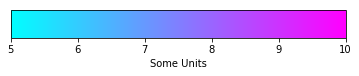

In [65]:
import matplotlib.pyplot as plt
import matplotlib as mpl

fig, ax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)

cmap = mpl.cm.cool
norm = mpl.colors.Normalize(vmin=5, vmax=10)

cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cmap,
                                norm=norm,
                                orientation='horizontal')
cb1.set_label('Some Units')
fig.show()


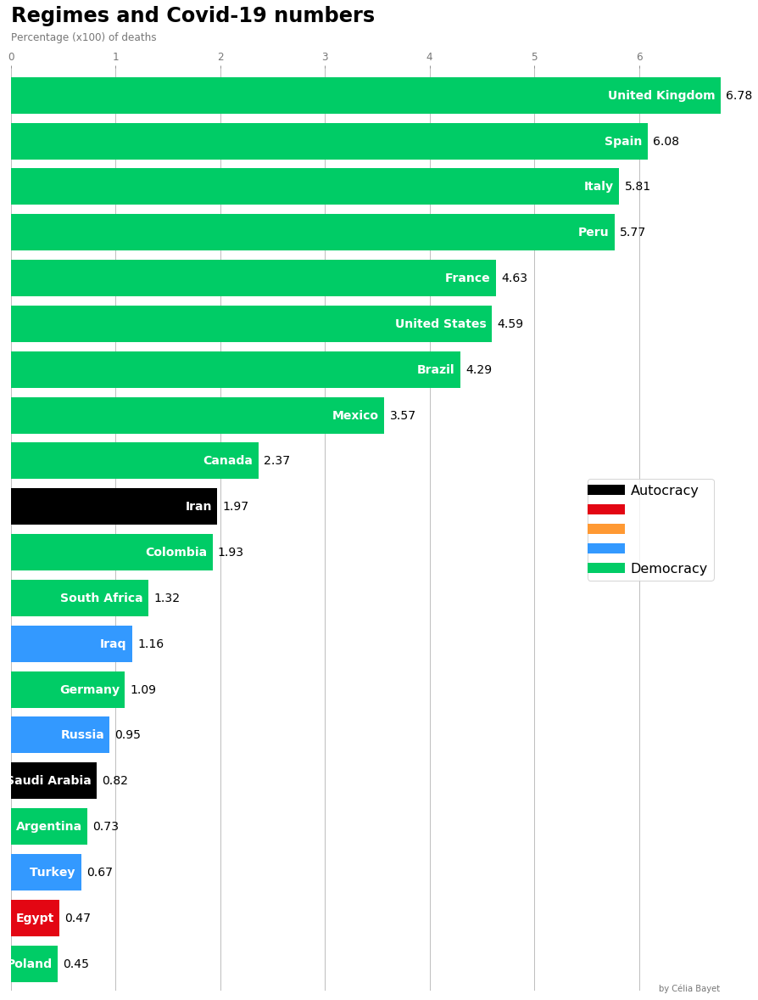

In [91]:
from matplotlib import cm
from matplotlib.lines import Line2D


fig, ax = plt.subplots(figsize=(15, 20))
def draw_barchart(df ,value):
    df = df.sort_values(by=value, ascending=True).tail(20)
    ax.clear()
    cax = ax.barh(df['location'], df[value]*100,color=[colors[group_lk[x]] for x in df['location']])
    dx = df[value].max() / 100 + 0.05
    for i, (values, name) in enumerate(zip(df[value]*100, df['location'])):
        ax.text(values-dx, i,     name,   color='#FFFFFF',        size=14, weight=600, ha='right', va='center')
        #ax.text(values-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        ax.text(values+dx, i, "{:.02f}".format(values), size=14, ha='left',  va='center')
    # ... polished styles
    #ax.text(1, 0.4, date, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(0, 1.03, 'Percentage (x100) of deaths', transform=ax.transAxes, size=12, color='#777777')
    #ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    
    flag = mpimg.imread('../data/country_flags/'+ name + '.png')
    imagebox = OffsetImage(flag, zoom=0.2)
    ab = AnnotationBbox(imagebox, (0.4, 0.6))
    ax.add_artist(ab)
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.05, 'Regimes and Covid-19 numbers',
            transform=ax.transAxes, size=24, weight=600, ha='left')
    ax.text(1, 0, 'by Célia Bayet', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
    

    custom_lines = [
        Line2D([0], [0], color=(0,0,0), lw=12),
        Line2D([0], [0], color=(0.89, 0.024, 0.075), lw=12),
        Line2D([0], [0], color=(1, 0.6, 0.2), lw=12),
        Line2D([0], [0], color=(0.2, 0.6, 1), lw=12),
        Line2D([0], [0], color=(0, 0.8, 0.4), lw=12)]
    ax.legend(custom_lines, ['Autocracy', ' ', ' ', ' ','Democracy'],  loc='center right', prop={'size': 16})
    
    
    
    
    plt.box(False)
    
draw_barchart(comparative_cases_democracy, 'percentage_deaths')

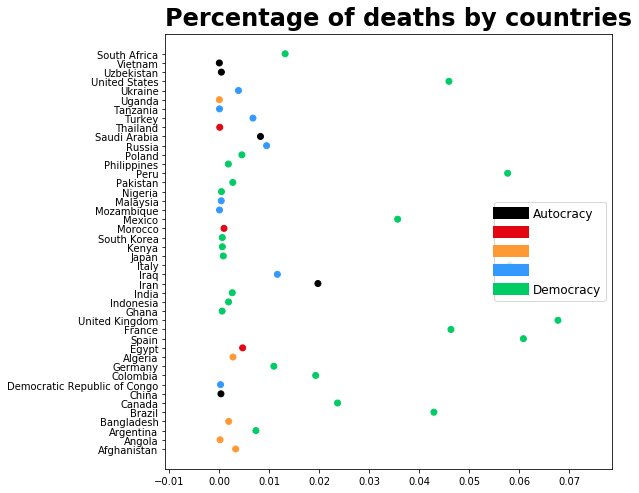

In [96]:
from matplotlib.lines import Line2D


fig, ax = plt.subplots(figsize=(8, 8))
def draw_scatter(df ,value):
    ax.clear()
    ax.scatter( df[value],df['location'], color=[colors[group_lk[x]] for x in df['location']])
    dx = df[value].max() / 200
    #for i, (values, name) in enumerate(zip(df[value], df['location'])):
        #ax.text(values-dx, i,     name,           size=14, weight=600, ha='right', va='bottom')
        #ax.text(values-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        #ax.text(values+dx, i, "{:.06f}".format(values),  size=14, ha='left',  va='center')
    # ... polished styles
    #ax.text(1, 0.4, date, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    #ax.text(0, 1.06, 'Deaths', transform=ax.transAxes, size=12, color='#777777')
    #ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    #ax.xaxis.set_ticks_position('top')
    #ax.tick_params(axis='x', colors='#777777', labelsize=12)
    #ax.set_yticks([])
    #ax.margins(0, 0.01)
    #ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.02, 'Percentage of deaths by countries',
            transform=ax.transAxes, size=24, weight=600, ha='left')
    #ax.legend(test, loc='center right', prop={'size': 16})
    custom_lines = [
        Line2D([0], [0], color=(0,0,0), lw=12),
        Line2D([0], [0], color=(0.89, 0.024, 0.075), lw=12),
        Line2D([0], [0], color=(1, 0.6, 0.2), lw=12),
        Line2D([0], [0], color=(0.2, 0.6, 1), lw=12),
        Line2D([0], [0], color=(0, 0.8, 0.4), lw=12)]
    ax.legend(custom_lines, ['Autocracy', ' ', ' ', ' ','Democracy'],  loc='center right', prop={'size': 12})
    
    
draw_scatter(comparative_cases_democracy, 'percentage_deaths')